In [208]:
import numpy as np
from sklearn import model_selection
from sklearn.datasets import load_iris
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

Загрузим один из "игрушечных" датасетов из sklearn.

In [209]:
X, y = load_iris(return_X_y=True)

# Для наглядности возьмем только первые два признака (всего в датасете их 4)
X = X[:, :2]

Разделим выборку на обучающую и тестовую

In [210]:
X_train, X_test, y_train, y_test = model_selection.train_test_split(X, y, test_size=0.2, random_state=1)

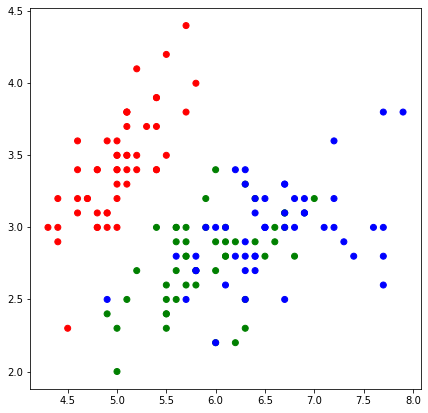

In [211]:
cmap = ListedColormap(['red', 'green', 'blue'])
plt.figure(figsize=(7, 7))
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=cmap)

Используем евклидову метрику. Реализуем функцию для ее подсчета.

In [212]:
def e_metrics(x1, x2):
    
    distance = 0
    for i in range(len(x1)):
        distance += np.square(x1[i] - x2[i])
    
    return np.sqrt(distance)

Реализуем алгоритм поиска k ближайших соседей.

In [213]:
def knn(x_train, y_train, x_test, k, weight_by_number=0, weight_by_distance=0):
    # waight_by_number: 0 or 1
    # weight_by_distnace: if 0 than off, overwise weight_by_distance have to lie in (0, 1)
    
    answers = []
    for x in x_test:
        test_distances = []
            
        for i in range(len(x_train)):
            
            # расчет расстояния от классифицируемого объекта до
            # объекта обучающей выборки
            distance = e_metrics(x, x_train[i])
            
            # Записываем в список значение расстояния и ответа на объекте обучающей выборки
            test_distances.append((distance, y_train[i]))
        
        # создаем словарь со всеми возможными классами
        classes = {class_item: 0 for class_item in set(y_train)}
        # Сортируем список и среди первых k элементов подсчитаем частоту появления разных классов
        # nullifier обнуляет часть не связанную с расстоянием, если weight_by_distance != 0.
        if weight_by_distance:
            nullifier = 0
        else:
            nullifier = 1 

        for i, d in enumerate(sorted(test_distances)[0:k]):
            classes[d[1]] += nullifier/(i * weight_by_number + 1) + weight_by_distance ** d[0]
            
        # Записываем в список ответов наиболее часто встречающийся класс
        answers.append(sorted(classes, key=classes.get)[-1])
    return answers

Напишем функцию для вычисления точности

In [214]:
def accuracy(pred, y):
    return (sum(pred == y) / len(y))

Проверим работу алгоритма при различных k

In [215]:
k = 1

y_pred = knn(X_train, y_train, X_test, k, weight_by_distance=0.5)

print(f'Точность алгоритма при k = {k}: {accuracy(y_pred, y_test):.3f}')

Точность алгоритма при k = 1: 0.667


Построим график распределения классов.

In [216]:
def get_graph(X_train, y_train, k):
    cmap_light = ListedColormap(['#FFAAAA', '#AAFFAA','#00AAFF'])

    h = .1

    # Расчет пределов графика
    x_min, x_max = X_train[:, 0].min() - 1, X_train[:, 0].max() + 1
    y_min, y_max = X_train[:, 1].min() - 1, X_train[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

    # Получим предсказания для всех точек
    Z = knn(X_train, y_train, np.c_[xx.ravel(), yy.ravel()], k)

    # Построим график
    Z = np.array(Z).reshape(xx.shape)
    plt.figure(figsize=(7,7))
    plt.pcolormesh(xx, yy, Z, cmap=cmap_light)

    # Добавим на график обучающую выборку
    plt.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap=cmap)
    plt.xlim(xx.min(), xx.max())
    plt.ylim(yy.min(), yy.max())
    plt.title(f"Трехклассовая kNN классификация при k = {k}")
    plt.show()

In [217]:
from tqdm.notebook import tqdm_notebook
list_of_accuracy = [[], [], []]
ks = list(range(1, 50))
for k in tqdm_notebook(ks):
    list_of_accuracy[0].append(accuracy(knn(X_train, y_train, X_test, k), y_test))
    list_of_accuracy[1].append(accuracy(knn(X_train, y_train, X_test, k, weight_by_number=1), y_test))
    list_of_accuracy[2].append(accuracy(knn(X_train, y_train, X_test, k, weight_by_distance=0.5), y_test))

Text(0.5, 1.0, '3 ways to introduce neighbors')

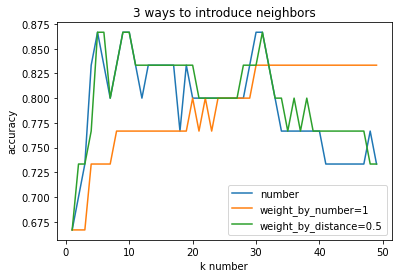

In [218]:
plt.plot(ks, list_of_accuracy[0], label='number')
plt.plot(ks, list_of_accuracy[1], label='weight_by_number=1')
plt.plot(ks, list_of_accuracy[2], label='weight_by_distance=0.5')
plt.legend(loc='lower right')
plt.xlabel('k number')
plt.ylabel('accuracy')
plt.title('3 ways to introduce neighbors')

Вообще мы не нормализовывали признаки, что странно, ну да ладно (они не очень отлиачются по своему диапазону).
По графику видно, что точность при расчете веса по номеру соседа, на данной выборке, растет медленней, чем при двух других типах, но при этом она не переобучается на больших значениях $k$. Так же видно, что наилучих значений к может быть несколько для одного метода.

In [219]:
max_acuracy = [[(i+1, method[i]) for i in range(len(method)) if method[i] == max(method)] for method in list_of_accuracy]
print(f'Метод по количеству соседей дает наилучшую точность = {max_acuracy[0][0][1]} на тестовом сете при к: \n{[i[0] for i in max_acuracy[0]]}')
print(f'Метод учитывающий соседей обратно пропорционально из номеру в очереди дает наилучшую точность = {max_acuracy[1][0][1]} на тестовом сете при к:\n{[i[0] for i in max_acuracy[1]]}')
print(f'Метод учитывающий расстояние до к соседей дает наилучшую точность = {max_acuracy[2][0][1]} на тестовом сете при к:\n{[i[0] for i in max_acuracy[2]]}')

Метод по количеству соседей дает наилучшую точность = 0.8666666666666667 на тестовом сете при к: 
[5, 9, 10, 30, 31]
Метод учитывающий соседей обратно пропорционально из номеру в очереди дает наилучшую точность = 0.8333333333333334 на тестовом сете при к:
[30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]
Метод учитывающий расстояние до к соседей дает наилучшую точность = 0.8666666666666667 на тестовом сете при к:
[5, 6, 9, 10, 31]


Видно что такой  алгоритм очень сильно зависит от датасета и от распределения в нем классов. $к$ нужно будет подбирать каждый раз. Не уверен что по такому графику действительно можео судить о том как работают подстройки. Скорей всего они работают в среднем одинаково, их нужно использовать в зависимости от решаемой задачи.

In [220]:
def graph_tree_hyperplane(X_train, y_train, k):
    cmap_light = ListedColormap(['#FFAAAA', '#AAFFAA','#00AAFF'])

    h = .05

    # Расчет пределов графика
    x_min, x_max = X_train[:, 0].min() - 1, X_train[:, 0].max() + 1
    y_min, y_max = X_train[:, 1].min() - 1, X_train[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

    # Получим предсказания для всех точек
    Z1 = knn(X_train, y_train, np.c_[xx.ravel(), yy.ravel()], k)
    Z2 = knn(X_train, y_train, np.c_[xx.ravel(), yy.ravel()], k, weight_by_number=1)
    Z3 = knn(X_train, y_train, np.c_[xx.ravel(), yy.ravel()], k, weight_by_distance=0.5)

    Z = [Z1, Z2, Z3]
    titles = ['closest', 'weight_by_number = 1', 'weight_by_distance = 0.5']
    plt.figure(figsize=(21, 7))
    for i in range(3):
        plt.subplot(1, 3, i+1)

        # Построим график
        Z[i] = np.array(Z[i]).reshape(xx.shape)
        plt.pcolormesh(xx, yy, Z[i], cmap=cmap_light)

        # Добавим на график обучающую выборку
        plt.scatter(X_train[:, 0], X_train[:, 1], c=y_train, cmap=cmap)
        plt.xlim(xx.min(), xx.max())
        plt.ylim(yy.min(), yy.max())
        plt.title(f'{titles[i]}, k = {k}')

Я уменьшил немного разрешение сетки, чтобы считалось быстрее и не лагали потом отрисованные графики.

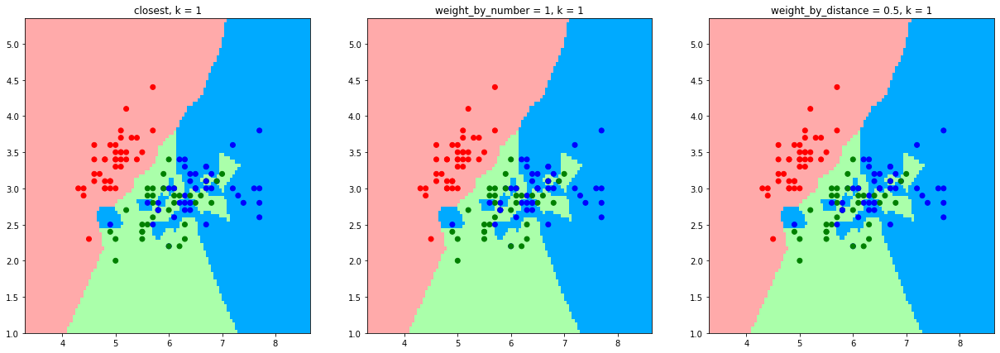

In [221]:
k = 1
graph_tree_hyperplane(X_train, y_train, k)

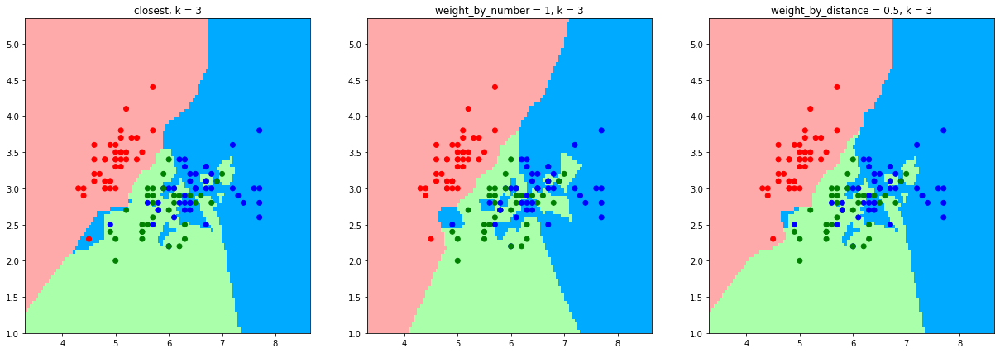

In [222]:
k = 3
graph_tree_hyperplane(X_train, y_train, k)

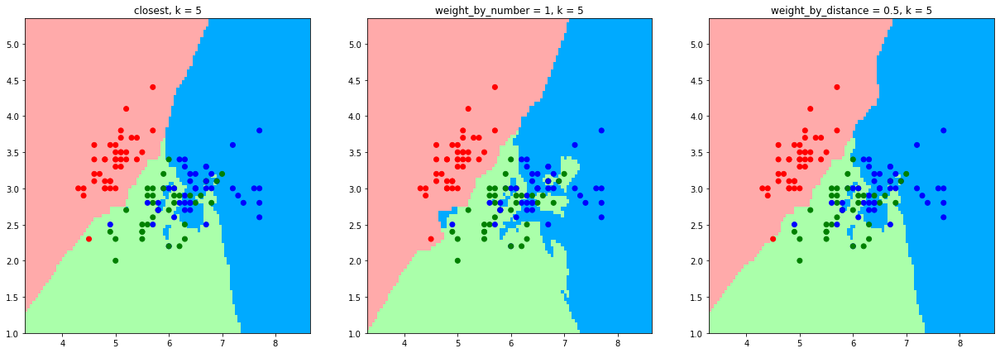

In [223]:
k = 5
graph_tree_hyperplane(X_train, y_train, k)

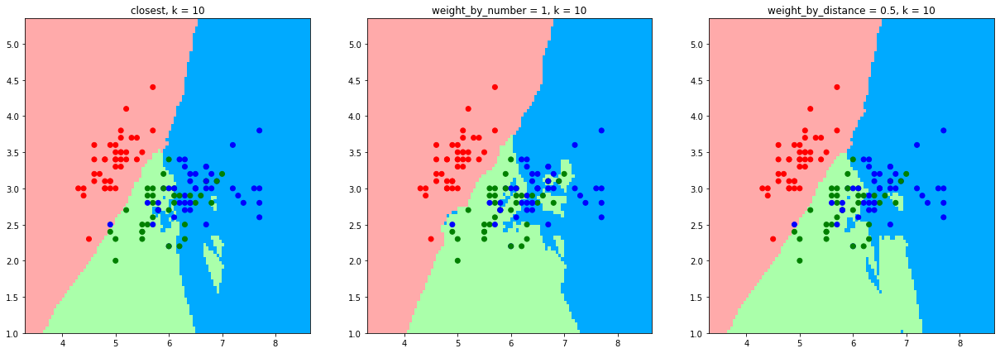

In [224]:
k = 10
graph_tree_hyperplane(X_train, y_train, k)

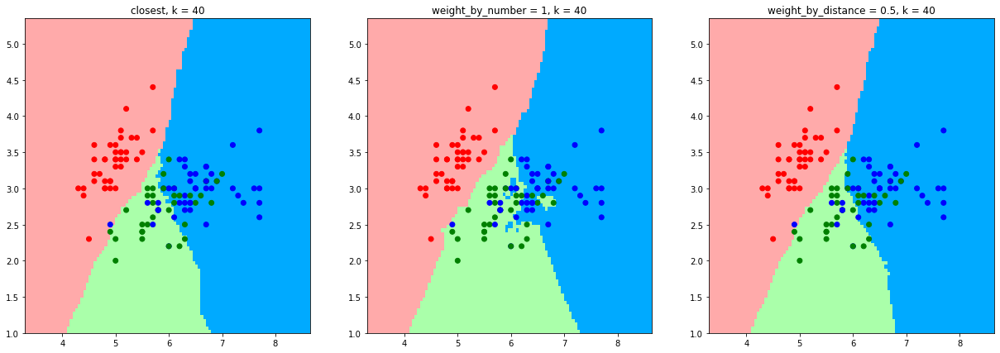

In [225]:
k = 40
graph_tree_hyperplane(X_train, y_train, k)

Красивые гиперплоскости, но на глаз достаточно сложно увидеть переобученность, видно что первый и третий методы на 40 полностью теряют детализацию. На самом, деле непонятно нужна ли она. По тестовой выборе видимо нужна.